# SCENIC+

## Check outputs

In [1]:
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42

In [ ]:
import os
os.chdir(os.getcwd())

In [3]:
import mudata
scplus_mdata = mudata.read("outs/scplusmdata.h5mu")

/opt/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:522: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/opt/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:522: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/opt/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:522: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/opt/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:522: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/opt/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:522: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/opt/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:522: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warning

In [4]:
scplus_mdata.uns["direct_e_regulon_metadata"]

,Region,Gene,importance_R2G,rho_R2G,importance_x_rho,importance_x_abs_rho,TF,is_extended,eRegulon_name,Gene_signature_name,Region_signature_name,importance_TF2G,regulation,rho_TF2G,triplet_rank
0,chr9:36154329-36154829,GLIPR2,0.055394,0.075054,0.004158,0.004158,ATF4,False,ATF4_direct_+/+,ATF4_direct_+/+_(609g),ATF4_direct_+/+_(624r),0.631570,1,0.142082,55158
1,chr15:45456660-45457160,BLOC1S6,0.074759,0.060669,0.004536,0.004536,ATF4,False,ATF4_direct_+/+,ATF4_direct_+/+_(609g),ATF4_direct_+/+_(624r),1.402409,1,0.315331,6062
2,chr5:131536399-131536899,FNIP1,0.029801,0.153126,0.004563,0.004563,ATF4,False,ATF4_direct_+/+,ATF4_direct_+/+_(609g),ATF4_direct_+/+_(624r),0.751166,1,0.361799,71476
3,chr14:49999176-49999676,ARF6,0.026568,0.079568,0.002114,0.002114,ATF4,False,ATF4_direct_+/+,ATF4_direct_+/+_(609g),ATF4_direct_+/+_(624r),1.273068,1,0.395456,76266
4,chr11:9264023-9264523,IPO7,0.019753,0.104291,0.002060,0.002060,ATF4,False,ATF4_direct_+/+,ATF4_direct_+/+_(609g),ATF4_direct_+/+_(624r),1.339734,1,0.389684,67408
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96956,chr16:88804519-88805019,APRT,0.003059,-0.071162,-0.000218,0.000218,XBP1,False,XBP1_direct_+/-,XBP1_direct_+/-_(698g),XBP1_direct_+/-_(417r),2.238679,1,0.466890,71391
96957,chr5:160008828-160009328,TTC1,0.098566,-0.104882,-0.010338,0.010338,XBP1,False,XBP1_direct_+/-,XBP1_direct_+/-_(698g),XBP1_direct_+/-_(417r),1.095072,1,0.327762,12894
96958,chrX:48539329-48539829,WAS,0.088548,-0.102911,-0.009113,0.009113,XBP1,False,XBP1_direct_+/-,XBP1_direct_+/-_(698g),XBP1_direct_+/-_(417r),2.294631,1,0.356383,414
96959,chr19:10416532-10417032,RAVER1,0.096747,-0.167279,-0.016184,0.016184,XBP1,False,XBP1_direct_+/-,XBP1_direct_+/-_(698g),XBP1_direct_+/-_(417r),1.080207,1,0.330656,8577


In [5]:
scplus_mdata.uns["direct_e_regulon_metadata"]['TF'].value_counts()#[:20]

ELF1       13091
KLF2       12002
KLF6       11502
ERG        10811
NR3C1       6823
FOS         6788
ETS2        5175
BCL11A      4502
BCLAF1      3450
RUNX1       2799
ILF3        2302
TCF3        2138
CHD1        2135
ELK3        2079
ATF4        1543
TCF4        1440
LEF1        1364
XBP1        1328
JUND        1310
EBF1        1032
SMARCC1     1005
FOSL2        942
POU2F2       488
FOSB         241
RUNX3        217
TAL1         217
GATA1        149
CHURC1        60
CCNT2         14
HMGA1         14
Name: TF, dtype: int64

In [6]:
scplus_mdata.uns["direct_e_regulon_metadata"]['TF'].unique()

array(['ATF4', 'BCL11A', 'BCLAF1', 'CCNT2', 'EBF1', 'ELF1', 'ELK3', 'ERG',
       'ETS2', 'FOS', 'FOSB', 'FOSL2', 'GATA1', 'JUND', 'KLF2', 'KLF6',
       'LEF1', 'NR3C1', 'POU2F2', 'RUNX1', 'RUNX3', 'SMARCC1', 'TAL1',
       'TCF3', 'TCF4', 'XBP1', 'CHD1', 'CHURC1', 'HMGA1', 'ILF3'],
      dtype=object)

In [7]:
scplus_mdata.uns["direct_e_regulon_metadata"]['TF'].nunique()

30

# eRegulon dim reduction

In [ ]:
import scanpy as sc
import anndata

/opt/venv/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/opt/venv/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


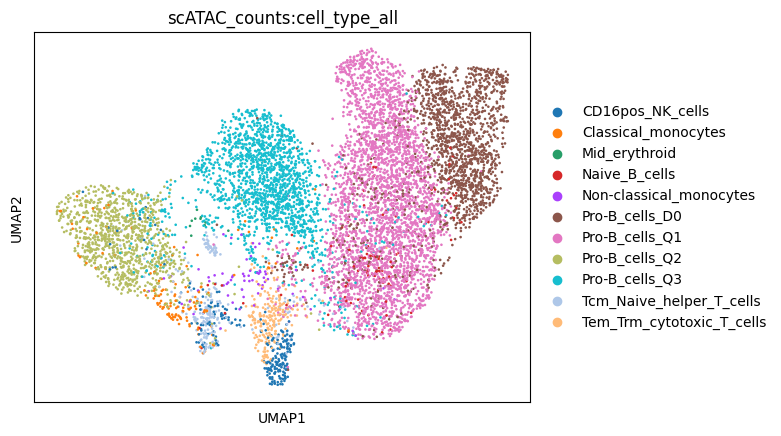

In [11]:
# do eregulon AUC only with direct gene based AUC
eRegulon_gene_AUC = anndata.concat(
    [scplus_mdata["direct_gene_based_AUC"]],
    axis = 1,
)
eRegulon_gene_AUC.obs = scplus_mdata.obs.loc[eRegulon_gene_AUC.obs_names]
sc.pp.neighbors(eRegulon_gene_AUC, use_rep = "X")
sc.tl.umap(eRegulon_gene_AUC)
sc.pl.umap(eRegulon_gene_AUC, color = "scATAC_counts:cell_type_all")

In [ ]:
# replace pro-b cells with tumour cells
cat_col = 'scATAC_counts:cell_type_all'

if 'Tumour' not in eRegulon_gene_AUC.obs[cat_col].cat.categories:
    eRegulon_gene_AUC.obs[cat_col] = eRegulon_gene_AUC.obs[cat_col].cat.add_categories(['Tumour_cells_D0','Tumour_cells_Q1', 'Tumour_cells_Q2', 'Tumour_cells_Q3'])


eRegulon_gene_AUC.obs[cat_col] = eRegulon_gene_AUC.obs[cat_col].replace('Pro-B', 'Tumour', regex=True)
eRegulon_gene_AUC.obs['scATAC_counts:cell_type_all'] = (
    eRegulon_gene_AUC.obs['scATAC_counts:cell_type_all'].cat.remove_unused_categories()
)

/opt/venv/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


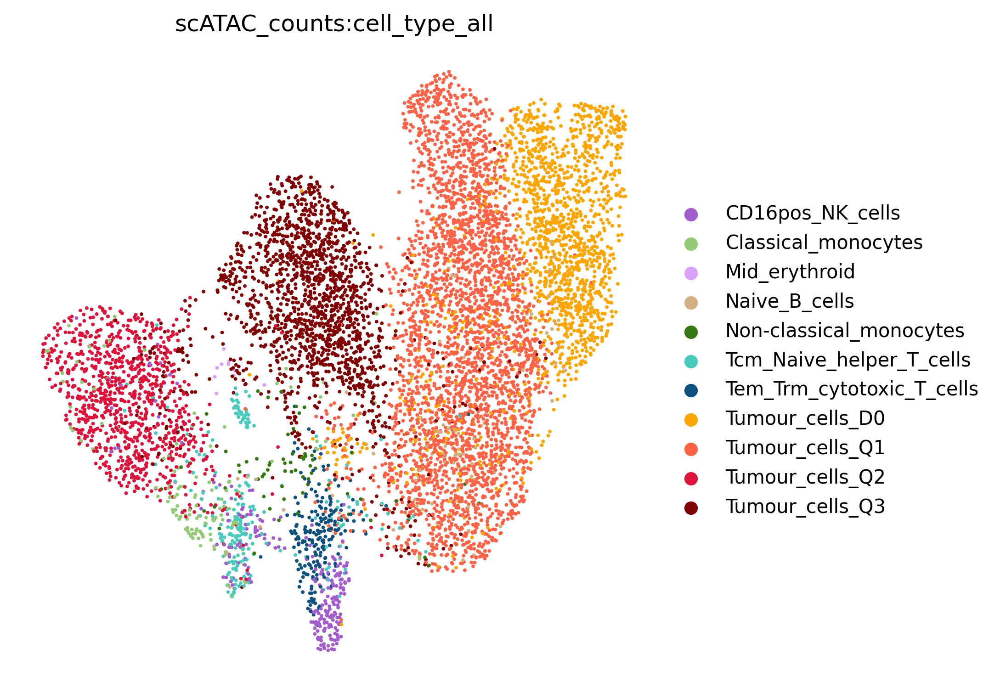

In [ ]:
from matplotlib import pyplot as plt
with plt.rc_context({"figure.figsize": (6, 6), "figure.dpi": 300, "figure.frameon": False}):
    ax = sc.pl.umap(eRegulon_gene_AUC, color="scATAC_counts:cell_type_all", show=False, frameon=False, palette = {
        "Naive_B_cells" : "#D2AF81FF",  
  "CD16pos_NK_cells":"#a25cce",
  "Classical_monocytes":"#94ca76", 
  "Mid_erythroid" : "#daa0fd", 
  "Non-classical_monocytes" : "#357711", 
  "Tcm_Naive_helper_T_cells":"#4acabd", 
  "Tem_Trm_cytotoxic_T_cells":"#0f517e",
  "Tumour_cells_D0":"#FFA500", 
  "Tumour_cells_Q1":"#FF6347", 
  "Tumour_cells_Q2":"#DC143C",
  "Tumour_cells_Q3": "#800101"
    }
                   )
    fig = ax.get_figure()
    
    # Add legend on the right side
    plt.legend(fontsize=10, loc='center left', bbox_to_anchor=(1, 0.5), frameon=False)
    
    plt.show()
    fig.savefig("figures/scATAC_counts_cell_type_all_eregulon__all_cells_umap.pdf", bbox_inches='tight')

In [15]:
eRegulon_gene_AUC

AnnData object with n_obs × n_vars = 8399 × 46
    obs: 'scRNA_counts:sample', 'scRNA_counts:n_genes_by_counts', 'scRNA_counts:log1p_n_genes_by_counts', 'scRNA_counts:total_counts', 'scRNA_counts:log1p_total_counts', 'scRNA_counts:pct_counts_in_top_20_genes', 'scRNA_counts:pct_counts_mt', 'scRNA_counts:pct_counts_ribo', 'scRNA_counts:pct_counts_hb', 'scRNA_counts:outlier', 'scRNA_counts:mt_outlier', 'scRNA_counts:ribo_outlier', 'scRNA_counts:doublet_score', 'scRNA_counts:predicted_doublet', 'scRNA_counts:leiden', 'scRNA_counts:leiden_0.05', 'scRNA_counts:leiden_0.5', 'scRNA_counts:leiden_0.6', 'scRNA_counts:leiden_0.75', 'scRNA_counts:leiden_0.8', 'scRNA_counts:leiden_0.85', 'scRNA_counts:leiden_0.9', 'scRNA_counts:leiden_0.95', 'scRNA_counts:leiden_1.0', 'scRNA_counts:leiden_1.25', 'scRNA_counts:leiden_1.5', 'scRNA_counts:leiden_2.0', 'scRNA_counts:leiden_5.0', 'scRNA_counts:leiden_10.0', 'scRNA_counts:leiden_20.0', 'scRNA_counts:celltypist_cell_label_coarse', 'scRNA_counts:celltypist

# eREgulon specificity score

In [16]:
from scenicplus.RSS import (regulon_specificity_scores, plot_rss)

In [17]:
rss = regulon_specificity_scores(
    scplus_mudata = scplus_mdata,
    variable = "scRNA_counts:celltypist_cell_label_fine",
    modalities = ["direct_gene_based_AUC", "extended_gene_based_AUC"]
)

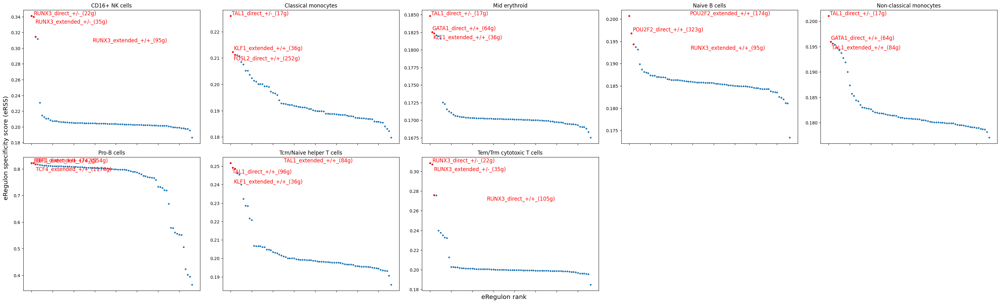

In [18]:
plot_rss(
    data_matrix = rss,
    top_n = 3,
    num_columns = 5
)

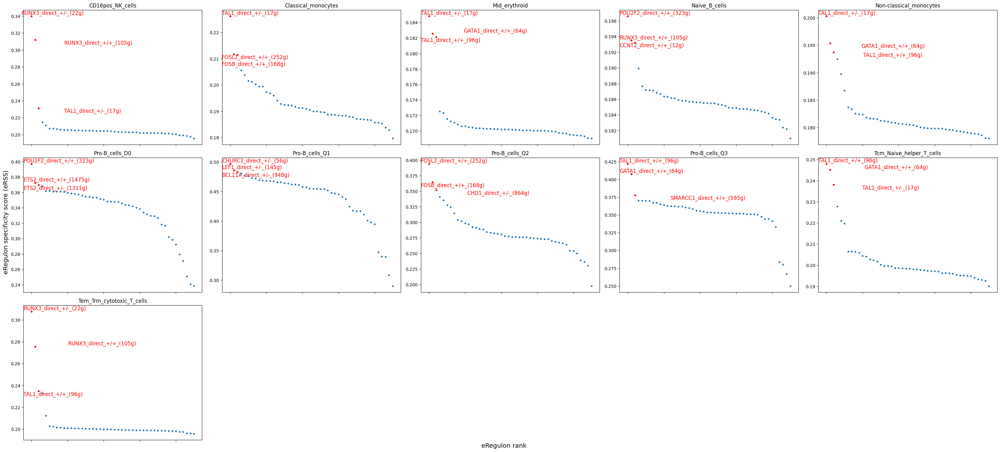

In [ ]:
rss = regulon_specificity_scores(
    scplus_mudata = scplus_mdata,
    variable = "scATAC_counts:cell_type_all",
    modalities = ["direct_gene_based_AUC"]
)

plot_rss(
    data_matrix = rss,
    top_n = 3,
    num_columns = 5
)

# eRegulon enrichment scores

/opt/venv/lib/python3.11/site-packages/IPython/core/pylabtools.py:152: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.canvas.print_figure(bytes_io, **kw)


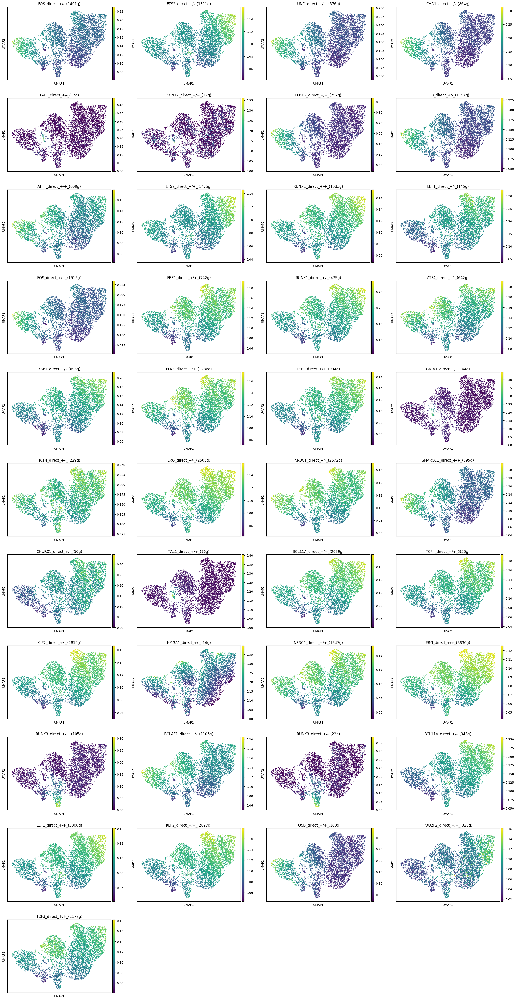

In [21]:
sc.pl.umap(eRegulon_gene_AUC, color = list(set([x for xs in [rss.loc[ct].sort_values()[0:15].index for ct in rss.index] for x in xs ])))


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


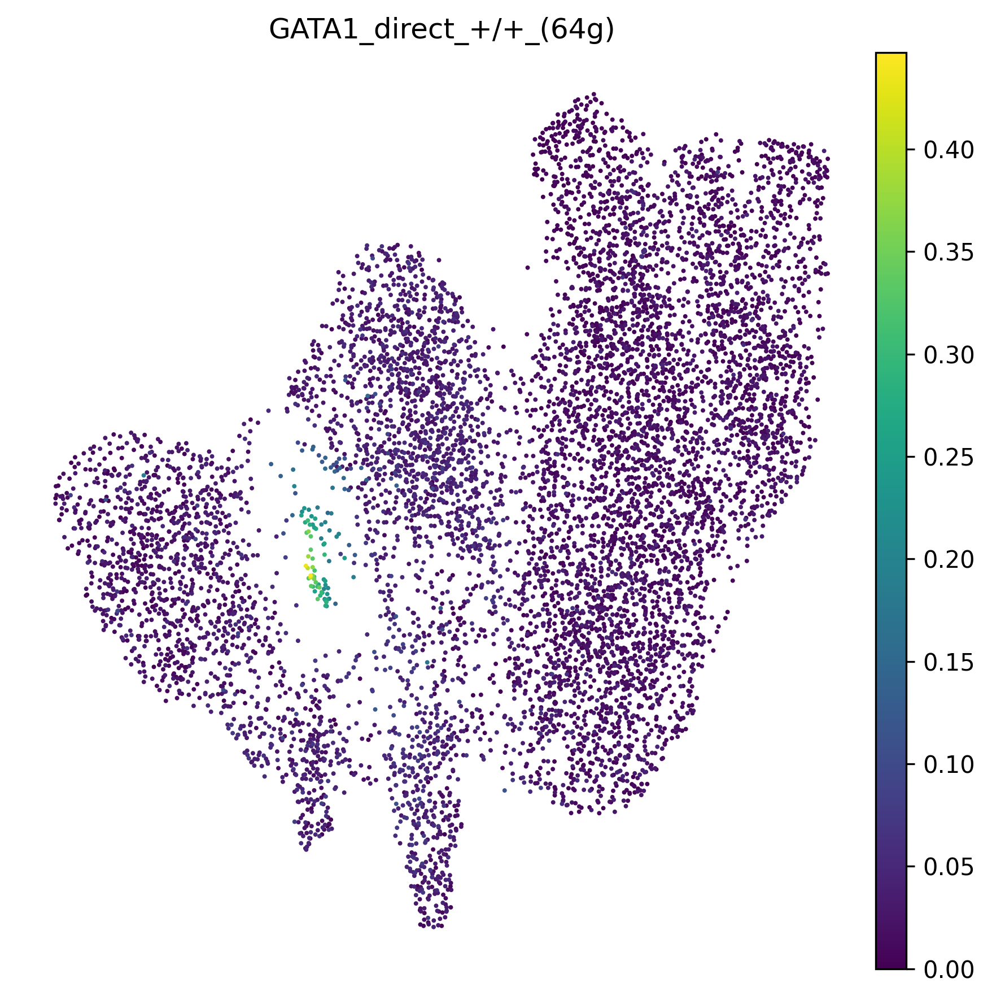

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


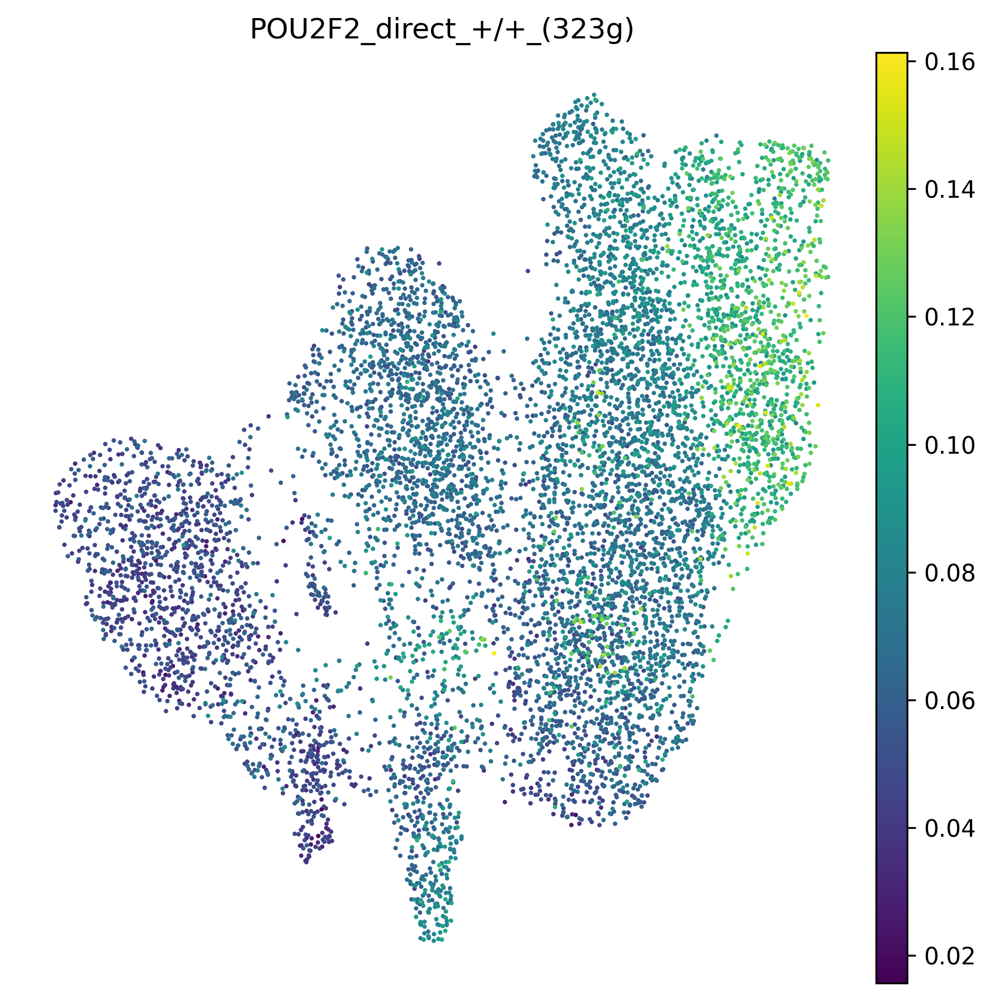

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


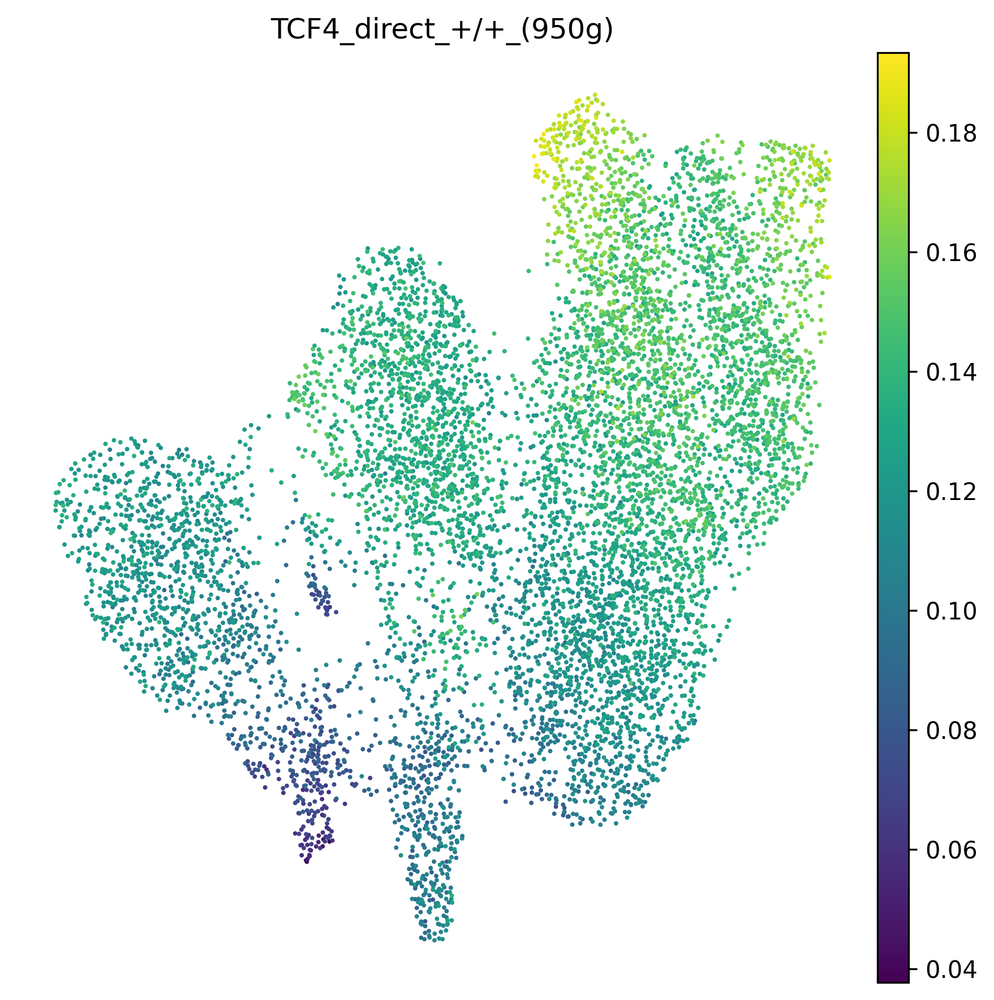

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


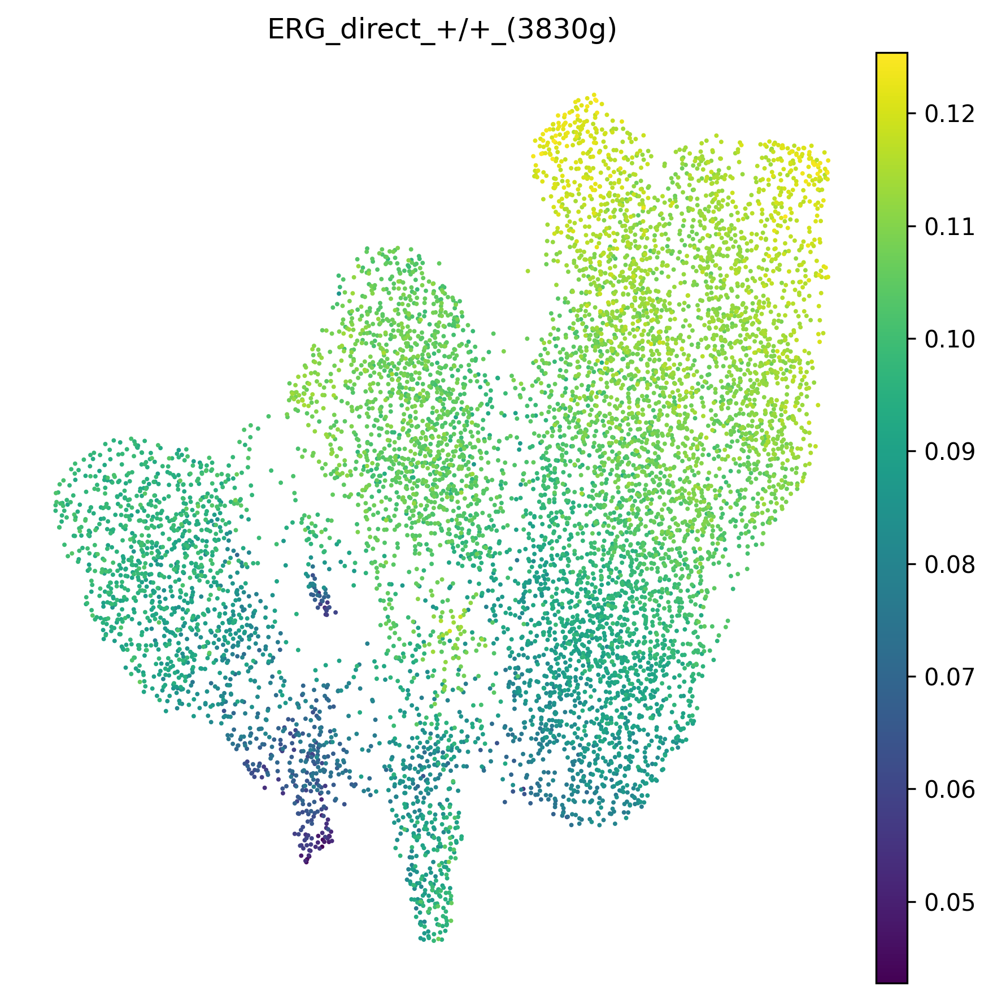

In [ ]:
ereg = ['GATA1_direct_+/+_(64g)','POU2F2_direct_+/+_(323g)','TCF4_direct_+/+_(950g)','ERG_direct_+/+_(3830g)']
for e in ereg:
    with plt.rc_context({"figure.figsize": (6, 6), "figure.dpi": 300, "figure.frameon": False}):
        ax = sc.pl.umap(eRegulon_gene_AUC, color=e, show=False, frameon=False)
        fig = ax.get_figure()
    
    # Add legend on the right side
        plt.legend(fontsize=10, loc='center left', bbox_to_anchor=(1, 0.5), frameon=False)
    
        plt.show()
        e = e.replace("/","_")
        fig.savefig(f"figures/{e}_activity_eregulon_umap.pdf", bbox_inches='tight')



In [23]:
eRegulon_gene_AUC

AnnData object with n_obs × n_vars = 8399 × 46
    obs: 'scRNA_counts:sample', 'scRNA_counts:n_genes_by_counts', 'scRNA_counts:log1p_n_genes_by_counts', 'scRNA_counts:total_counts', 'scRNA_counts:log1p_total_counts', 'scRNA_counts:pct_counts_in_top_20_genes', 'scRNA_counts:pct_counts_mt', 'scRNA_counts:pct_counts_ribo', 'scRNA_counts:pct_counts_hb', 'scRNA_counts:outlier', 'scRNA_counts:mt_outlier', 'scRNA_counts:ribo_outlier', 'scRNA_counts:doublet_score', 'scRNA_counts:predicted_doublet', 'scRNA_counts:leiden', 'scRNA_counts:leiden_0.05', 'scRNA_counts:leiden_0.5', 'scRNA_counts:leiden_0.6', 'scRNA_counts:leiden_0.75', 'scRNA_counts:leiden_0.8', 'scRNA_counts:leiden_0.85', 'scRNA_counts:leiden_0.9', 'scRNA_counts:leiden_0.95', 'scRNA_counts:leiden_1.0', 'scRNA_counts:leiden_1.25', 'scRNA_counts:leiden_1.5', 'scRNA_counts:leiden_2.0', 'scRNA_counts:leiden_5.0', 'scRNA_counts:leiden_10.0', 'scRNA_counts:leiden_20.0', 'scRNA_counts:celltypist_cell_label_coarse', 'scRNA_counts:celltypist

# Heatmat doptplot

In [25]:
from scenicplus.plotting.dotplot import heatmap_dotplot

In [28]:
scplus_mdata

MuData object with n_obs × n_vars = 8399 × 258332
  uns:	'direct_e_regulon_metadata', 'extended_e_regulon_metadata'
  6 modalities
    scRNA_counts:	8399 x 36601
      obs:	'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'pct_counts_mt', 'pct_counts_ribo', 'pct_counts_hb', 'outlier', 'mt_outlier', 'ribo_outlier', 'doublet_score', 'predicted_doublet', 'leiden', 'leiden_0.05', 'leiden_0.5', 'leiden_0.6', 'leiden_0.75', 'leiden_0.8', 'leiden_0.85', 'leiden_0.9', 'leiden_0.95', 'leiden_1.0', 'leiden_1.25', 'leiden_1.5', 'leiden_2.0', 'leiden_5.0', 'leiden_10.0', 'leiden_20.0', 'celltypist_cell_label_coarse', 'celltypist_conf_score_coarse', 'celltypist_cell_label_fine', 'celltypist_conf_score_fine', 'base_index'
      var:	'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
      obsm:	'X_pca', 'X_umap'
    scATAC_counts:	8399 x 221577
      obs:	'log10_total_fragments_count', 'pdf_values_for_tss_enrichment', 'cisTopic_log_nr_acc', 'cisTopic_nr_acc', 'barcode_rank', 'log10_unique_fragments_count', 'total_fragments_in_peaks_count', 'cisTopic_nr_frag', 'unique_fragments_in_peaks_count', 'log10_unique_fragments_in_peaks_count', 'total_fragments_count', 'duplication_ratio', 'tss_enrichment', 'cisTopic_log_nr_frag', 'pdf_values_for_duplication_ratio', 'log10_total_fragments_in_peaks_count', 'duplication_count', 'pdf_values_for_fraction_of_fragments_in_peaks', 'unique_fragments_count', 'fraction_of_fragments_in_peaks', 'barcode', 'cell_type', 'sample_id', 'pycisTopic_leiden_10_0.2', 'pycisTopic_leiden_10_0.3', 'pycisTopic_leiden_10_0.6', 'pycisTopic_leiden_10_1.2', 'pycisTopic_leiden_10_3', 'pycisTopic_leiden_10_6', 'is_nan', 'cell_type_all'
      var:	'Chromosome', 'Start', 'End', 'Width', 'cisTopic_nr_frag', 'cisTopic_log_nr_frag', 'cisTopic_nr_acc', 'cisTopic_log_nr_acc'
      obsm:	'UMAP', 'tSNE'
    direct_gene_based_AUC:	8399 x 46
    direct_region_based_AUC:	8399 x 46
    extended_gene_based_AUC:	8399 x 31
    extended_region_based_AUC:	8399 x 31

In [29]:
scplus_mdata['scATAC_counts'].obs['cell_type_all'] = scplus_mdata['scATAC_counts'].obs['cell_type_all'].str.replace('Pro-B', 'Tumour', regex= True)

In [30]:
scplus_mdata['scATAC_counts'].obs['cell_type_all'] = scplus_mdata['scATAC_counts'].obs['cell_type_all'].str.replace('_', ' ', regex= True)

In [ ]:
heatmap_dotplot(
    scplus_mudata = scplus_mdata,
    color_modality = "direct_gene_based_AUC",
    size_modality = "direct_region_based_AUC",
    group_variable = "scATAC_counts:cell_type_all",
    eRegulon_metadata_key = "direct_e_regulon_metadata",
    color_feature_key = "Gene_signature_name",
    size_feature_key = "Region_signature_name",
    feature_name_key = "eRegulon_name",
    sort_data_by = "direct_gene_based_AUC",
    orientation = "vertical",
    figsize = (24, 10),
    save = ("figures/dotplot_heatmap_scenicplus_direct_allcells.pdf")
)

/opt/venv/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 24 x 10 in image.
/opt/venv/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: figures/dotplot_heatmap_scenicplus_direct_allcells.pdf


# Check TF from eRegulon expression

In [41]:
import numpy as np
from scipy.cluster.hierarchy import linkage, leaves_list
import matplotlib.pyplot as plt

In [42]:
scplus_mdata.uns['direct_e_regulon_metadata']['TF'].unique()

array(['ATF4', 'BCL11A', 'BCLAF1', 'CCNT2', 'EBF1', 'ELF1', 'ELK3', 'ERG',
       'ETS2', 'FOS', 'FOSB', 'FOSL2', 'GATA1', 'JUND', 'KLF2', 'KLF6',
       'LEF1', 'NR3C1', 'POU2F2', 'RUNX1', 'RUNX3', 'SMARCC1', 'TAL1',
       'TCF3', 'TCF4', 'XBP1', 'CHD1', 'CHURC1', 'HMGA1', 'ILF3'],
      dtype=object)

In [ ]:
rna = sc.read_h5ad("/path/to/rna/concatenated_adata_log_pca_celltypist_23012025.h5ad")
rna.obs['celltypist_cell_label_fine'] = rna.obs['celltypist_cell_label_fine'].astype(str).replace('Pro-B', 'Tumour', regex= True)

TF = scplus_mdata.uns['direct_e_regulon_metadata']['TF'].unique()

In [45]:
# rename pro-B cells to tumor cells
mask = rna.obs['celltypist_cell_label_fine'] == 'Tumour cells'
rna.obs.loc[mask, 'celltypist_cell_label_fine'] = (
    rna.obs.loc[mask, 'celltypist_cell_label_fine'].astype(str) + ' ' + rna.obs.loc[mask, 'sample'].astype(str)
)

/opt/venv/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
/tmp/ipykernel_3760215/545426045.py:21: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
/opt/venv/lib/python3.11/site-packages/IPython/core/pylabtools.py:152: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


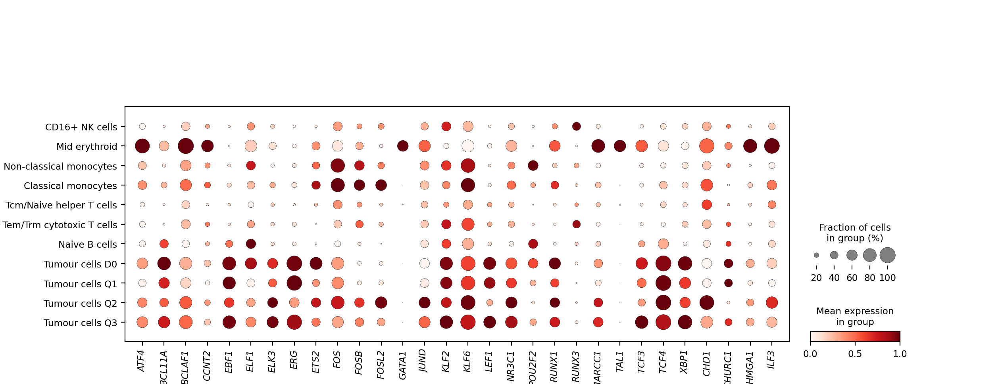

In [ ]:
dp = sc.pl.dotplot(rna, TF, groupby='celltypist_cell_label_fine', mean_only_expressed = False, standard_scale='var',
                   show=False,
                 categories_order=  [
        'CD16+ NK cells',
        'Mid erythroid',
        'Non-classical monocytes',
        'Classical monocytes',
        'Tcm/Naive helper T cells',
        'Tem/Trm cytotoxic T cells',
        'Naive B cells',
        'Tumour cells D0',
        'Tumour cells Q1',
        'Tumour cells Q2',
        'Tumour cells Q3'
    ])

ax = dp["mainplot_ax"]
# italicize the gene labels
for l in ax.get_xticklabels():
    l.set_style("italic")
plt.savefig("./figures/SCENICplus_TF_expression.pdf", dpi=300, bbox_inches="tight")


In [49]:
rna.X = rna.layers['log_counts']

['GATA1' 'HMBS' 'ALAS2' 'ABCB6' 'TFR2' 'EPB42' 'BEST3' 'RIPOR3' 'DNAJC6'
 'LTBP1' 'GYPE' 'CHST2' 'CCRL2' 'CD36' 'TRIM10' 'DMTN' 'LRRC47' 'SLC40A1'
 'SLC4A1' 'AHSP' 'HEMGN' 'SNCA' 'BSG' 'CAT' 'UBAC1' 'HBG1' 'ACSL6' 'KLF1'
 'FLCN' 'CD59']


/opt/venv/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
/tmp/ipykernel_3760215/2547380130.py:44: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
/opt/venv/lib/python3.11/site-packages/IPython/core/pylabtools.py:152: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


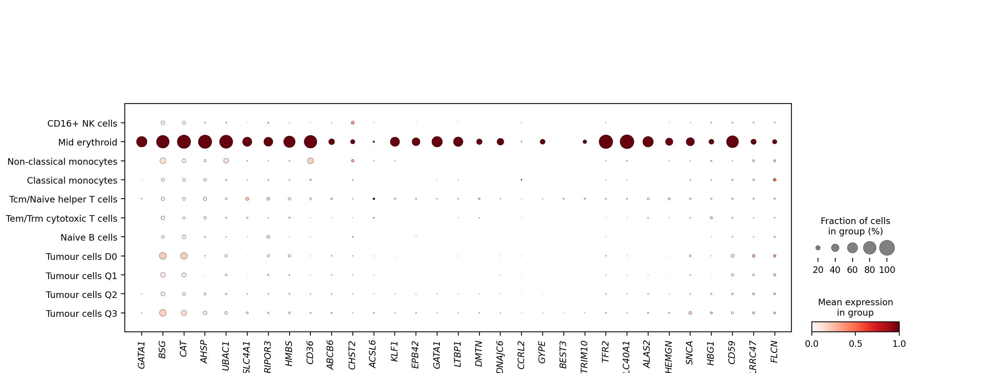

['TRAPPC2L' 'TAS2R14' 'ANKRD37' 'OGDH' 'BAHCC1' 'FAAP100' 'RAB37' 'MYO3B'
 'EML1' 'ATP23' 'LYN' 'WDFY4' 'SPIB' 'CD37' 'SHLD3' 'TSPO' 'OVCA2'
 'RABEP2' 'GPSM3' 'SLX1B' 'TNFRSF1B' 'C16orf74' 'SLC15A2' 'NAMPT' 'IL3RA'
 'TTYH3' 'SLC25A29' 'PPIA' 'MAP3K1' 'ATF6B']


/opt/venv/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
/tmp/ipykernel_3760215/2547380130.py:44: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
/opt/venv/lib/python3.11/site-packages/IPython/core/pylabtools.py:152: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


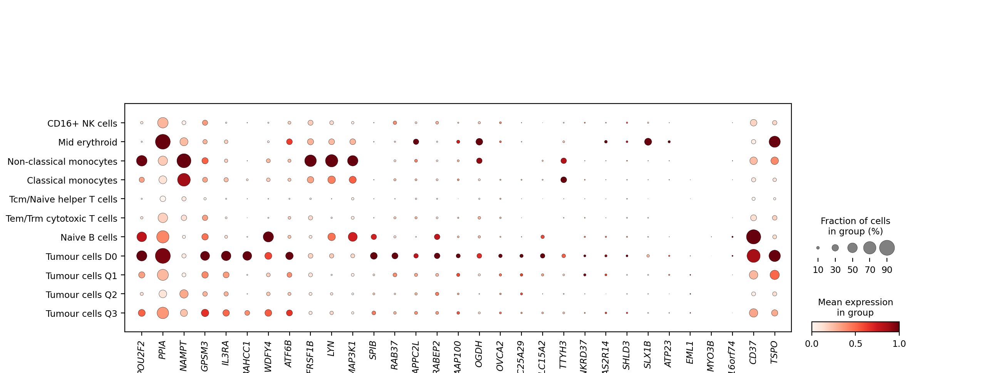

['RPS4X' 'EBF1' 'RPL7A' 'BCL11A' 'CENPW' 'FIP1L1' 'USP8' 'RPS7' 'ZBTB20'
 'RPS27A' 'DEAF1' 'RPL13' 'RPL11' 'TCFL5' 'RPL23A' 'GABPB1' 'SON' 'FAU'
 'REL' 'CUX1' 'GNA12' 'CD37' 'PGM2L1' 'EIF3F' 'RPS8' 'IKZF1' 'SP3'
 'TASOR2' 'AUTS2' 'ZNF793']


/opt/venv/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
/tmp/ipykernel_3760215/2547380130.py:44: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
/opt/venv/lib/python3.11/site-packages/IPython/core/pylabtools.py:152: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


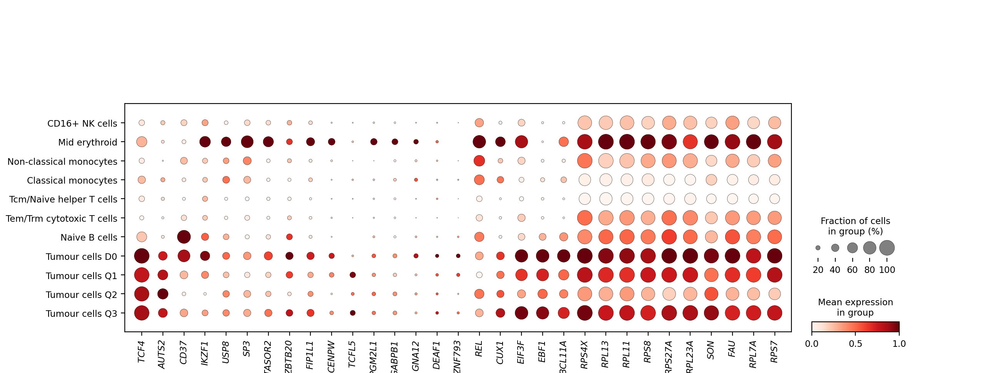

['TTC14' 'KRT10' 'PEX2' 'UPRT' 'RPL10' 'PLEKHG4B' 'ATP5MG' 'BMS1'
 'GPATCH2' 'RPS27A' 'RPL5' 'SMIM26' 'ERG' 'LPAR6' 'RASGRP2' 'RPL13'
 'TOPBP1' 'MRPL13' 'MEF2C' 'CHIC1' 'SF3A1' 'RPL6' 'ALMS1' 'RPS12' 'RPL18'
 'EEF1A1' 'PFDN4' 'RPS4X' 'RPS10' 'RPS18']


/opt/venv/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
/tmp/ipykernel_3760215/2547380130.py:44: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
/opt/venv/lib/python3.11/site-packages/IPython/core/pylabtools.py:152: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


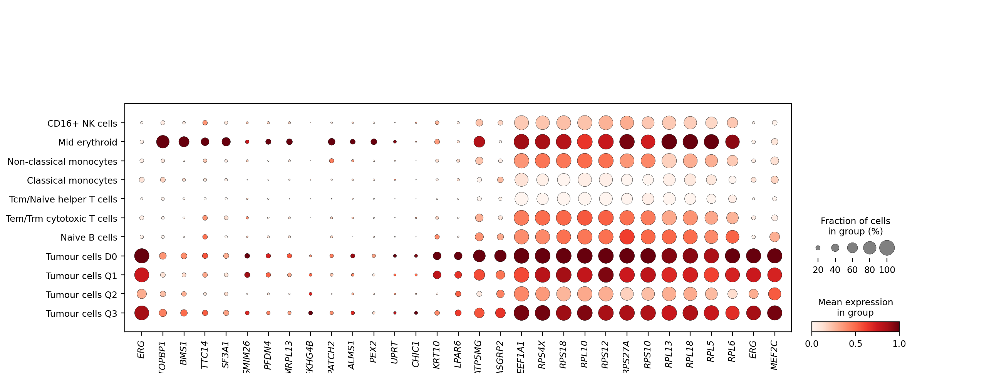

In [ ]:
ereg = ['GATA1_direct_+/+_(64g)','POU2F2_direct_+/+_(323g)','TCF4_direct_+/+_(950g)','ERG_direct_+/+_(3830g)']


for tf_interest in ereg:
    tf = tf_interest.split('_')[0]

    reg = scplus_mdata.uns["direct_e_regulon_metadata"].sort_values('triplet_rank')
    reg = reg[reg['Gene_signature_name'] == tf_interest]['Gene'].unique()
    reg = reg[:30] # take top 30 genes max
    reg

    # cluster genes
    expression_data = rna[:, reg].layers['log_counts'].toarray()
    gene_linkage = linkage(expression_data.T, method='complete')
    gene_order = leaves_list(gene_linkage)
    ordered_genes = [reg[i] for i in gene_order]


    print(reg)
    ordered_genes = np.append(tf,ordered_genes)
    dp = sc.pl.dotplot(rna, ordered_genes, groupby='celltypist_cell_label_fine', mean_only_expressed = False, standard_scale='var',
                   show=False,
                 categories_order=  [
        'CD16+ NK cells',
        'Mid erythroid',
        'Non-classical monocytes',
        'Classical monocytes',
        'Tcm/Naive helper T cells',
        'Tem/Trm cytotoxic T cells',
        'Naive B cells',
        'Tumour cells D0',
        'Tumour cells Q1',
        'Tumour cells Q2',
        'Tumour cells Q3'
    ])



    ax = dp["mainplot_ax"]
    for l in ax.get_xticklabels():
        l.set_style("italic")
    tf_interest = tf_interest.replace("/","_")
    plt.savefig(f"./figures/SCENICplus_{tf_interest}_expression_eregulon.pdf", dpi=300, bbox_inches="tight")
    plt.show()


['PPDPF' 'RPS3A' 'DLGAP2' 'TCF25' 'MR1' 'FAM135A' 'RPL8' 'DGKQ' 'YIF1B'
 'ATP5PO' 'HCLS1' 'LRBA' 'ANKFY1' 'CCDC91' 'DAD1' 'RPTOR' 'ETFDH'
 'SIPA1L3' 'ZZEF1' 'CCDC117' 'FIP1L1' 'CBR1' 'ZNF605' 'CFAP298' 'PSMG4'
 'FIS1' 'CHEK2' 'PHF14' 'MRPS6' 'KCNK6']


/opt/venv/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
/tmp/ipykernel_3760215/2762142469.py:41: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
/opt/venv/lib/python3.11/site-packages/IPython/core/pylabtools.py:152: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


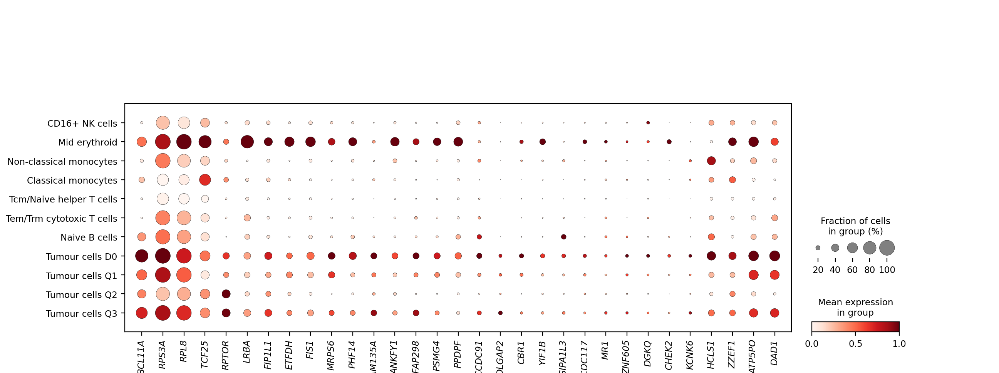

In [60]:
tf_interest = 'BCL11A'

reg = scplus_mdata.uns["direct_e_regulon_metadata"].sort_values('triplet_rank')
reg = reg[reg['TF'] == tf_interest]['Gene'].unique()
reg = reg[:30]
reg

# cluster genes
expression_data = rna[:, reg].layers['log_counts'].toarray()
gene_linkage = linkage(expression_data.T, method='complete')
gene_order = leaves_list(gene_linkage)
ordered_genes = [reg[i] for i in gene_order]


print(reg)
ordered_genes = np.append(tf_interest,ordered_genes)
dp = sc.pl.dotplot(rna, ordered_genes, groupby='celltypist_cell_label_fine', mean_only_expressed = False, standard_scale='var',
                   show=False,
                 categories_order=  [
        'CD16+ NK cells',
        'Mid erythroid',
        'Non-classical monocytes',
        'Classical monocytes',
        'Tcm/Naive helper T cells',
        'Tem/Trm cytotoxic T cells',
        'Naive B cells',
        'Tumour cells D0',
        'Tumour cells Q1',
        'Tumour cells Q2',
        'Tumour cells Q3'
    ])

# dp = sc.pl.dotplot(adata, ["CD79A", "MS4A1"], "bulk_labels", show=False)
# All Axes used in dotplot
#print("Dotplot axes:", dp)
# Select the Axes object that contains the subplot of interest
ax = dp["mainplot_ax"]
# Loop through ticklabels and make them italic
for l in ax.get_xticklabels():
    l.set_style("italic")
plt.savefig(f"./figures/SCENICplus_{tf_interest}_expression_eregulon.pdf", dpi=300, bbox_inches="tight")


# cytoscape

In [61]:
eRegulon_gene_AUC

AnnData object with n_obs × n_vars = 8399 × 46
    obs: 'scRNA_counts:sample', 'scRNA_counts:n_genes_by_counts', 'scRNA_counts:log1p_n_genes_by_counts', 'scRNA_counts:total_counts', 'scRNA_counts:log1p_total_counts', 'scRNA_counts:pct_counts_in_top_20_genes', 'scRNA_counts:pct_counts_mt', 'scRNA_counts:pct_counts_ribo', 'scRNA_counts:pct_counts_hb', 'scRNA_counts:outlier', 'scRNA_counts:mt_outlier', 'scRNA_counts:ribo_outlier', 'scRNA_counts:doublet_score', 'scRNA_counts:predicted_doublet', 'scRNA_counts:leiden', 'scRNA_counts:leiden_0.05', 'scRNA_counts:leiden_0.5', 'scRNA_counts:leiden_0.6', 'scRNA_counts:leiden_0.75', 'scRNA_counts:leiden_0.8', 'scRNA_counts:leiden_0.85', 'scRNA_counts:leiden_0.9', 'scRNA_counts:leiden_0.95', 'scRNA_counts:leiden_1.0', 'scRNA_counts:leiden_1.25', 'scRNA_counts:leiden_1.5', 'scRNA_counts:leiden_2.0', 'scRNA_counts:leiden_5.0', 'scRNA_counts:leiden_10.0', 'scRNA_counts:leiden_20.0', 'scRNA_counts:celltypist_cell_label_coarse', 'scRNA_counts:celltypist

In [64]:
test = scplus_mdata.uns["direct_e_regulon_metadata"].sort_values('triplet_rank').head(2000)
test[test.TF =='TCF4']

,Region,Gene,importance_R2G,rho_R2G,importance_x_rho,importance_x_abs_rho,TF,is_extended,eRegulon_name,Gene_signature_name,Region_signature_name,importance_TF2G,regulation,rho_TF2G,triplet_rank
95978,chr11:119087658-119088158,RPS25,0.006578,-0.189815,-0.001249,0.001249,TCF4,False,TCF4_direct_+/-,TCF4_direct_+/-_(229g),TCF4_direct_+/-_(167r),6.989411,1,0.760247,237
51862,chrX:72308781-72309281,RPS4X,0.123533,0.381473,0.047125,0.047125,TCF4,False,TCF4_direct_+/+,TCF4_direct_+/+_(950g),TCF4_direct_+/+_(849r),7.959735,1,0.786614,321
95902,chr12:112386882-112387382,RPL6,0.070810,-0.064184,-0.004545,0.004545,TCF4,False,TCF4_direct_+/-,TCF4_direct_+/-_(229g),TCF4_direct_+/-_(167r),7.976194,1,0.748959,542
96049,chr4:26141824-26142324,RBPJ,0.026216,-0.051504,-0.001350,0.001350,TCF4,False,TCF4_direct_+/-,TCF4_direct_+/-_(229g),TCF4_direct_+/-_(167r),5.783143,1,0.588701,546
51210,chr5:158756918-158757418,EBF1,0.029876,0.355723,0.010628,0.010628,TCF4,False,TCF4_direct_+/+,TCF4_direct_+/+_(950g),TCF4_direct_+/+_(849r),6.821123,1,0.725050,769
51459,chr9:133440787-133441287,RPL7A,0.043210,0.201335,0.008700,0.008700,TCF4,False,TCF4_direct_+/+,TCF4_direct_+/+_(950g),TCF4_direct_+/+_(849r),8.031150,1,0.766569,790
95921,chr9:127455580-127456080,RPL12,0.001310,-0.100017,-0.000131,0.000131,TCF4,False,TCF4_direct_+/-,TCF4_direct_+/-_(229g),TCF4_direct_+/-_(167r),6.658491,1,0.709579,842
51677,chr2:60366131-60366631,BCL11A,0.036276,0.349278,0.012671,0.012671,TCF4,False,TCF4_direct_+/+,TCF4_direct_+/+_(950g),TCF4_direct_+/+_(849r),5.400353,1,0.706134,887
51428,chr6:126255089-126255589,CENPW,0.414335,0.141534,0.058642,0.058642,TCF4,False,TCF4_direct_+/+,TCF4_direct_+/+_(950g),TCF4_direct_+/+_(849r),1.393349,1,0.334719,1031
96143,chr6:170438375-170438875,PSMB1,0.074032,-0.124560,-0.009221,0.009221,TCF4,False,TCF4_direct_+/-,TCF4_direct_+/-_(229g),TCF4_direct_+/-_(167r),2.354623,1,0.592771,1160


In [81]:
import pandas as pd
ereg = ['GATA1_direct_+/+_(64g)','POU2F2_direct_+/+_(323g)','TCF4_direct_+/+_(950g)','ERG_direct_+/+_(3830g)']
for tf_interest in ereg:
    tf = tf_interest.split('_')[0]

    reg = scplus_mdata.uns["direct_e_regulon_metadata"].sort_values('triplet_rank')
    reg = reg[reg.Gene_signature_name == tf_interest].loc[:,['TF','Gene','Region']].head(50) #['Gene'].unique
    reg.to_csv(f'regulons/{tf}_direct_regulons_top50.csv', index= False)
    reg

In [68]:
scplus_mdata.uns["direct_e_regulon_metadata"]['Gene_signature_name'].nunique()

46

In [69]:
pip list

Package                              Version
------------------------------------ -----------------
adjustText                           1.0.4
aiohttp                              3.9.3
aiosignal                            1.3.1
anndata                              0.10.5.post1
annoy                                1.17.3
appdirs                              1.4.4
arboreto                             0.1.6
argparse-dataclass                   2.0.0
array_api_compat                     1.5.1
asttokens                            2.4.1
attr                                 0.3.2
attrs                                23.2.0
bbknn                                1.6.0
beautifulsoup4                       4.12.3
bidict                               0.23.1
bioservices                          1.11.2
blosc2                               2.5.1
bokeh                                3.4.0
boltons                              23.1.1
bs4                                  0.0.2
cattrs                     

In [71]:
ereg = ['GATA1_direct_+/+_(64g)','POU2F2_direct_+/+_(323g)','TCF4_direct_+/+_(950g)','ERG_direct_+/+_(3830g)']


for tf_interest in ereg:
    tf = tf_interest.split('_')[0]

    reg = scplus_mdata.uns["direct_e_regulon_metadata"].sort_values('triplet_rank')
    reg = reg[reg['Gene_signature_name'] == tf_interest]['Gene'].unique()
    print(tf)
    #print(reg)
    print(len(set(reg)))


GATA1
64
POU2F2
323
TCF4
950
ERG
3830


In [75]:
reg = scplus_mdata.uns["direct_e_regulon_metadata"].sort_values('triplet_rank')
reg[(reg['Gene_signature_name'] == 'TCF4_direct_+/+_(950g)') & (reg['Gene'] == 'AUTS2')]

,Region,Gene,importance_R2G,rho_R2G,importance_x_rho,importance_x_abs_rho,TF,is_extended,eRegulon_name,Gene_signature_name,Region_signature_name,importance_TF2G,regulation,rho_TF2G,triplet_rank
51792,chr7:70006346-70006846,AUTS2,0.022793,0.118550,0.002702,0.002702,TCF4,False,TCF4_direct_+/+,TCF4_direct_+/+_(950g),TCF4_direct_+/+_(849r),2.450257,1,0.656237,4429
51930,chr7:70406435-70406935,AUTS2,0.005067,0.269146,0.001364,0.001364,TCF4,False,TCF4_direct_+/+,TCF4_direct_+/+_(950g),TCF4_direct_+/+_(849r),2.450257,1,0.656237,39457
52010,chr7:69953408-69953908,AUTS2,0.001596,0.093748,0.000150,0.000150,TCF4,False,TCF4_direct_+/+,TCF4_direct_+/+_(950g),TCF4_direct_+/+_(849r),2.450257,1,0.656237,39700
51881,chr7:70416497-70416997,AUTS2,0.013748,0.107788,0.001482,0.001482,TCF4,False,TCF4_direct_+/+,TCF4_direct_+/+_(950g),TCF4_direct_+/+_(849r),2.450257,1,0.656237,54659
51600,chr7:70700632-70701132,AUTS2,0.007303,0.215865,0.001576,0.001576,TCF4,False,TCF4_direct_+/+,TCF4_direct_+/+_(950g),TCF4_direct_+/+_(849r),2.450257,1,0.656237,59508


In [76]:
reg = scplus_mdata.uns["direct_e_regulon_metadata"].sort_values('triplet_rank')
reg[(reg['Gene_signature_name'] == 'ERG_direct_+/+_(3830g)') & (reg['Gene'] == 'MEF2C')]

,Region,Gene,importance_R2G,rho_R2G,importance_x_rho,importance_x_abs_rho,TF,is_extended,eRegulon_name,Gene_signature_name,Region_signature_name,importance_TF2G,regulation,rho_TF2G,triplet_rank
22012,chr5:88827156-88827656,MEF2C,0.098558,0.157926,0.015565,0.015565,ERG,False,ERG_direct_+/+,ERG_direct_+/+_(3830g),ERG_direct_+/+_(4210r),5.609592,1,0.813032,87


In [80]:
reg = scplus_mdata.uns["direct_e_regulon_metadata"].sort_values('triplet_rank')
reg[(reg['Gene_signature_name'] == 'POU2F2_direct_+/+_(323g)') & (reg['Gene'] == 'CD37')]

,Region,Gene,importance_R2G,rho_R2G,importance_x_rho,importance_x_abs_rho,TF,is_extended,eRegulon_name,Gene_signature_name,Region_signature_name,importance_TF2G,regulation,rho_TF2G,triplet_rank
44925,chr19:49326064-49326564,CD37,0.088917,0.377269,0.033546,0.033546,POU2F2,False,POU2F2_direct_+/+,POU2F2_direct_+/+_(323g),POU2F2_direct_+/+_(392r),2.32607,1,0.462415,15474
44866,chr19:49390991-49391491,CD37,0.017374,0.116432,0.002023,0.002023,POU2F2,False,POU2F2_direct_+/+,POU2F2_direct_+/+_(323g),POU2F2_direct_+/+_(392r),2.32607,1,0.462415,21381


In [79]:
reg = scplus_mdata.uns["direct_e_regulon_metadata"].sort_values('triplet_rank')
reg[(reg['Gene_signature_name'] == 'POU2F2_direct_+/+_(323g)')]

,Region,Gene,importance_R2G,rho_R2G,importance_x_rho,importance_x_abs_rho,TF,is_extended,eRegulon_name,Gene_signature_name,Region_signature_name,importance_TF2G,regulation,rho_TF2G,triplet_rank
45193,chr16:88942013-88942513,TRAPPC2L,0.006783,0.093446,0.000634,0.000634,POU2F2,False,POU2F2_direct_+/+,POU2F2_direct_+/+_(323g),POU2F2_direct_+/+_(392r),0.306874,1,0.192773,448
45058,chr12:10982244-10982744,TAS2R14,0.509584,0.074705,0.038069,0.038069,POU2F2,False,POU2F2_direct_+/+,POU2F2_direct_+/+_(323g),POU2F2_direct_+/+_(392r),0.305017,1,0.170922,1274
45056,chr4:185470085-185470585,ANKRD37,0.017052,0.056774,0.000968,0.000968,POU2F2,False,POU2F2_direct_+/+,POU2F2_direct_+/+_(323g),POU2F2_direct_+/+_(392r),0.605979,1,0.162213,3964
45262,chr7:44795729-44796229,OGDH,0.059446,0.174163,0.010353,0.010353,POU2F2,False,POU2F2_direct_+/+,POU2F2_direct_+/+_(323g),POU2F2_direct_+/+_(392r),2.522445,1,0.282799,4386
44892,chr17:81412258-81412758,BAHCC1,0.001428,0.137610,0.000196,0.000196,POU2F2,False,POU2F2_direct_+/+,POU2F2_direct_+/+_(323g),POU2F2_direct_+/+_(392r),0.982896,1,0.313475,4876
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45171,chr11:64852144-64852644,MAP4K2,0.008319,0.137167,0.001141,0.001141,POU2F2,False,POU2F2_direct_+/+,POU2F2_direct_+/+_(323g),POU2F2_direct_+/+_(392r),0.346477,1,0.246771,96794
45114,chr16:1474207-1474707,CLCN7,0.004947,0.083091,0.000411,0.000411,POU2F2,False,POU2F2_direct_+/+,POU2F2_direct_+/+_(323g),POU2F2_direct_+/+_(392r),0.362005,1,0.257131,96826
44975,chr8:141254429-141254929,PTP4A3,0.001040,0.123270,0.000128,0.000128,POU2F2,False,POU2F2_direct_+/+,POU2F2_direct_+/+_(323g),POU2F2_direct_+/+_(392r),0.604613,1,0.262900,96888
44912,chr16:88860897-88861397,TRAPPC2L,0.003983,0.102011,0.000406,0.000406,POU2F2,False,POU2F2_direct_+/+,POU2F2_direct_+/+_(323g),POU2F2_direct_+/+_(392r),0.306874,1,0.192773,96916
